## In this file, we will focus ourselves in the choice of which model we want to keep
## The creation of the dcgan and its training will be done in the file dcgan.ipynb

In [18]:
import ipynb.fs.full.dcgan as dcgan

import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

import warnings
warnings.filterwarnings('ignore')

In [19]:
path = 'data/'
enum = ['all', 'bug', 'dark', 'dragon', 'electric', 'fairy', 'fighting', 'fire', 'flying', 'ghost', 'grass', 'ground', 'ice', 'normal', 'poison', 'psychic', 'rock', 'steel', 'water']

In [20]:
rnd = random.Random()
rd = rnd.randint(0, len(enum))
random_type = enum[rd]
random_type = 'all'
print("Type(s) chosen for creating new Pokemon : " + random_type)

Type(s) chosen for creating new Pokemon : rock


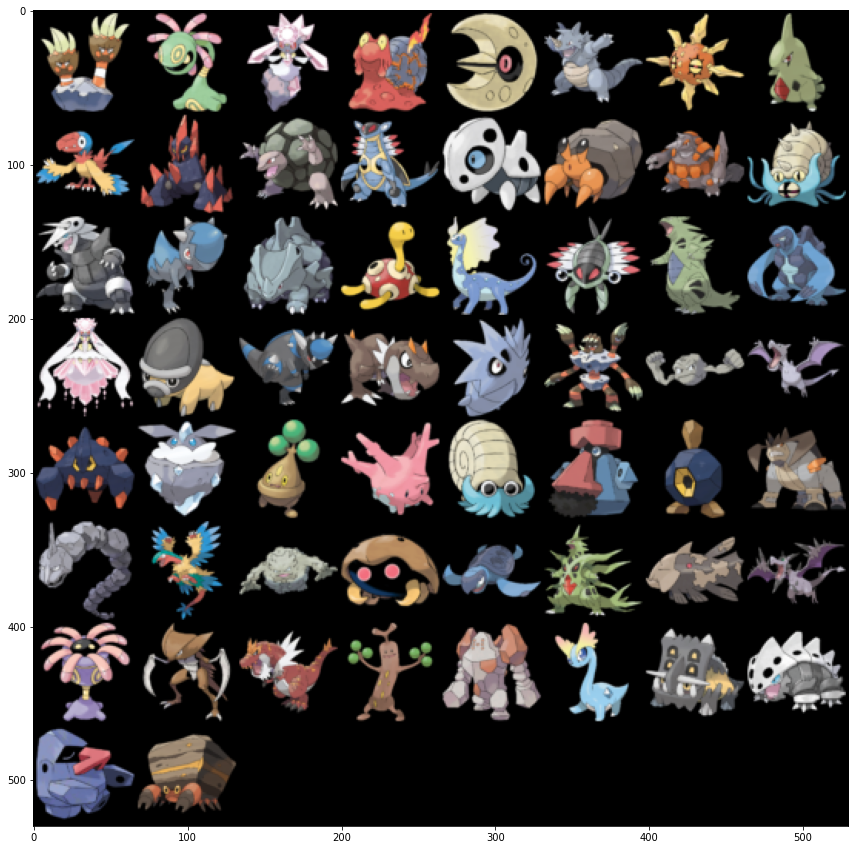

In [21]:
trainloader = dcgan.create_trainloader(path + random_type, 64, 64)
dcgan.show_some_pokemon(trainloader, 64, 8)

In [22]:
generator = dcgan.create_generator()
discriminator = dcgan.create_discriminator()

In [23]:
res_gen, res_dis, images, losses = dcgan.machine_learning(trainloader, generator, discriminator, epochs = 500)

Epoch: 1 / 500 	Discriminator Loss: 0.030182 	Generator Loss: 0.043573 	D(x): 0.584104 	D(G(z)): 5.859680
Epoch: 2 / 500 	Discriminator Loss: 0.007402 	Generator Loss: 0.029437 	D(x): 0.928391 	D(G(z)): 10.694627
Epoch: 3 / 500 	Discriminator Loss: 0.003074 	Generator Loss: 0.022583 	D(x): 0.941658 	D(G(z)): 11.272765
Epoch: 4 / 500 	Discriminator Loss: 0.001332 	Generator Loss: 0.018077 	D(x): 0.929678 	D(G(z)): 9.470847
Epoch: 5 / 500 	Discriminator Loss: 0.000740 	Generator Loss: 0.014041 	D(x): 0.932313 	D(G(z)): 5.829084
Epoch: 6 / 500 	Discriminator Loss: 0.000485 	Generator Loss: 0.011848 	D(x): 0.950798 	D(G(z)): 5.065060
Epoch: 7 / 500 	Discriminator Loss: 0.000509 	Generator Loss: 0.010203 	D(x): 0.965330 	D(G(z)): 7.314611
Epoch: 8 / 500 	Discriminator Loss: 0.000401 	Generator Loss: 0.009973 	D(x): 0.967021 	D(G(z)): 9.150044
Epoch: 9 / 500 	Discriminator Loss: 0.000329 	Generator Loss: 0.009018 	D(x): 0.964208 	D(G(z)): 8.777520
Epoch: 10 / 500 	Discriminator Loss: 0.00026

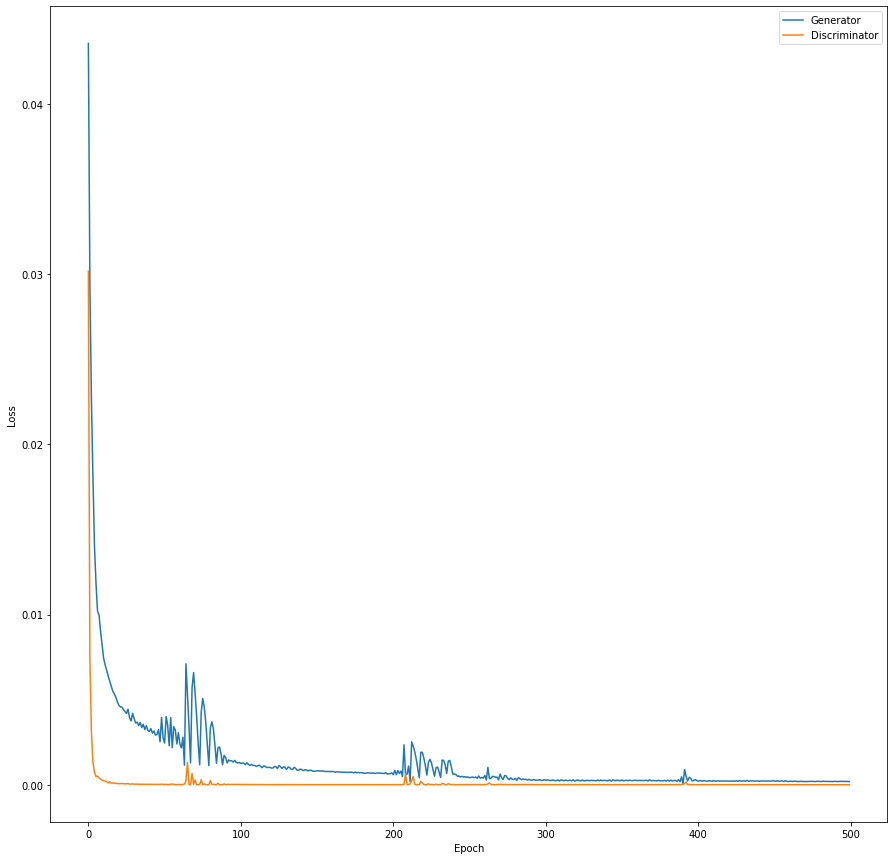

In [24]:
dcgan.show_losses(losses[0], losses[1])

Animation size has reached 21363448 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


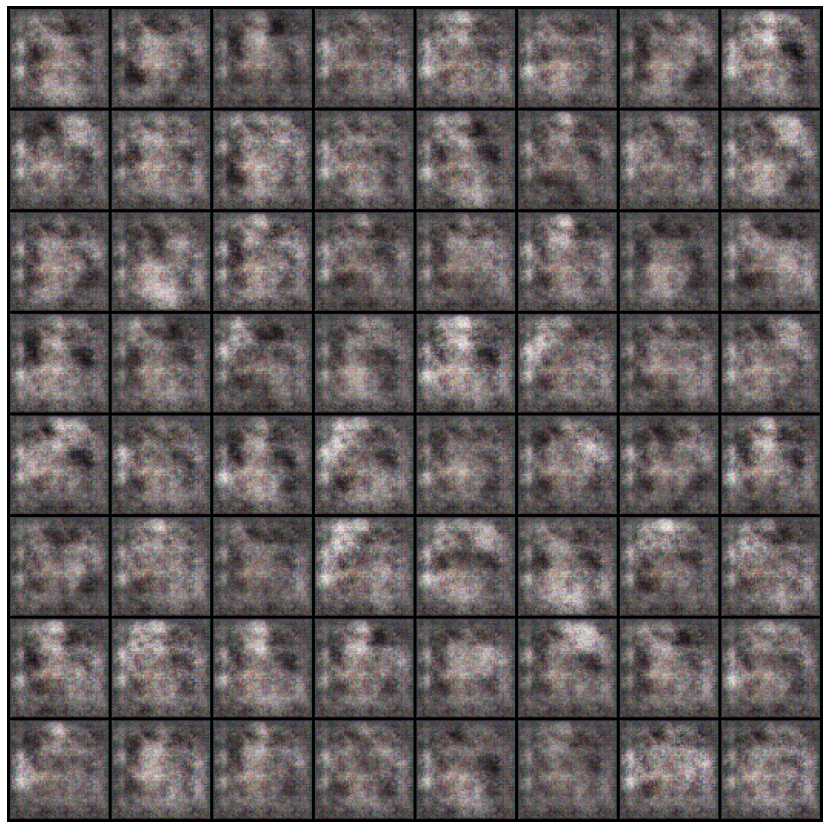

In [25]:
fig = plt.figure(figsize = (15, 15))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated = True)] for i in images[::5]]
ani = animation.ArtistAnimation(fig, ims, interval=250, repeat_delay=250, blit=True)
HTML(ani.to_jshtml())

In [26]:
saving_gen = 'models/Generator/'
saving_dis = 'models/Discriminator/'

In [27]:
dcgan.save_gen(generator, saving_gen + random_type + '.pth')
dcgan.save_dis(discriminator, saving_dis + random_type + '.pth')

In [28]:
loading_gen = 'models/Generator/'
loading_dis = 'models/Discriminator/'

In [29]:
modelG = dcgan.load_gen(loading_gen, random_type)

In [30]:
ims = dcgan.fakemons(modelG)

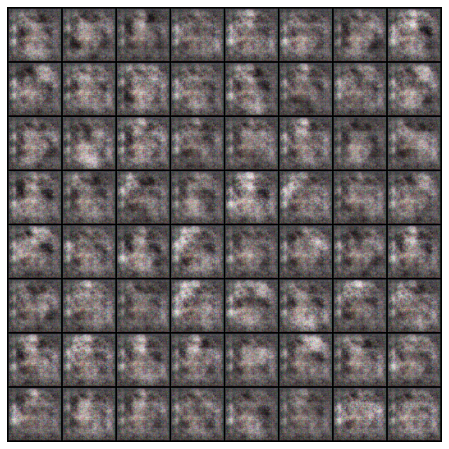

In [31]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated = True)] for i in images[::15]]